In [1]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from keras.preprocessing import image
import numpy as np

Using TensorFlow backend.


In [2]:
import keras.backend.tensorflow_backend as KTF
import os
import tensorflow as tf
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.5, allow_growth=True)
config = tf.ConfigProto(gpu_options=gpu_options)

In [3]:
img_path = '/home/data/datasets/classification/dogs-vs-cats/evaluation/cat/80.jpg'

In [4]:
img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor /= 255.
img_tensor = np.expand_dims(img_tensor, axis=0)
print(img_tensor.shape)

(1, 224, 224, 3)


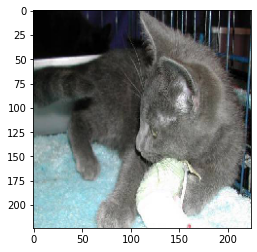

In [5]:
plt.imshow(img_tensor[0])

In [6]:
import sys
sys.path.append('../')
from nets.alexnet import AlexNet
from nets.vgg import VGGNet19

In [7]:
model_vgg = VGGNet19(
    input_shape=(224, 224, 3),
    batch_norm='before_activation',
    classes=2
).model
model_vgg.load_weights('../models/cats-vs-dogs/vgg19_bn_before_activation/model/vgg19.h5')

In [8]:
from keras import models

In [9]:
layer_outputs = [layer.output for layer in model_vgg.layers if 'relu' in layer.name]

In [10]:
layer_names = [layer.name for layer in model_vgg.layers if 'relu' in layer.name]

In [11]:
len(layer_outputs), len(layer_names)

(16, 16)

In [12]:
activation_model = models.Model(inputs=model_vgg.input, outputs=layer_outputs)

In [13]:
activations = activation_model.predict(img_tensor)

In [14]:
len(activations)

16

In [15]:
def show_activations(image_per_row):
    for layer_name, layer_activation in zip(layer_names, activations):
        channel_num = layer_activation.shape[-1]

        size = layer_activation.shape[1]

        column_num = channel_num // image_per_row

        display_grid = np.zeros((size * column_num, image_per_row * size))

        for col in range(column_num):
            for row in range(image_per_row):
                channel_image = layer_activation[0, :, :, col * image_per_row + row]
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')

                display_grid[
                    col * size : (col + 1) * size,
                    row * size : (row + 1) * size
                ] = channel_image

        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)

        plt.imshow(display_grid, aspect='auto', cmap='viridis')

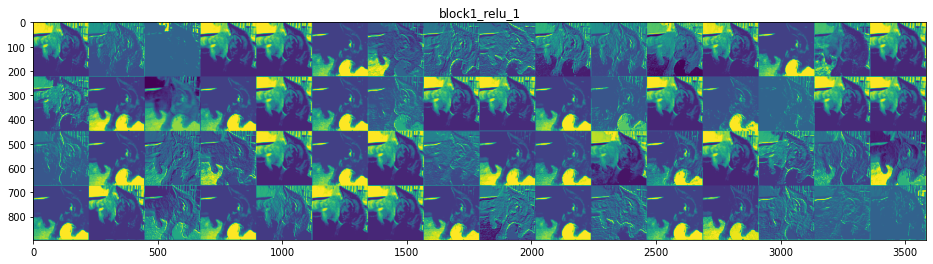

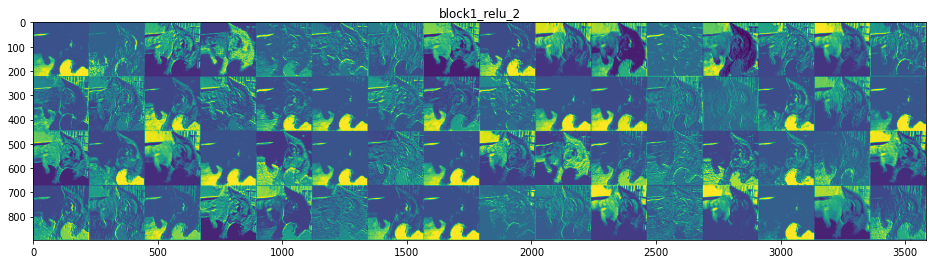

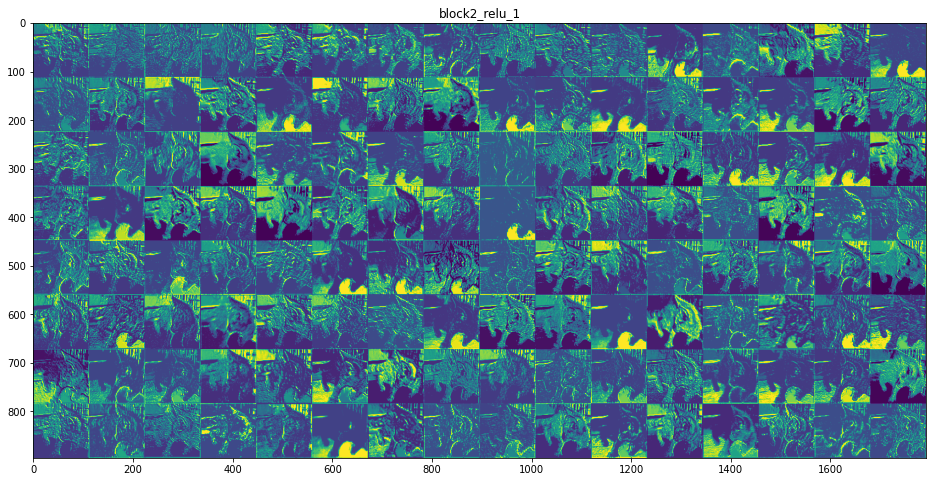

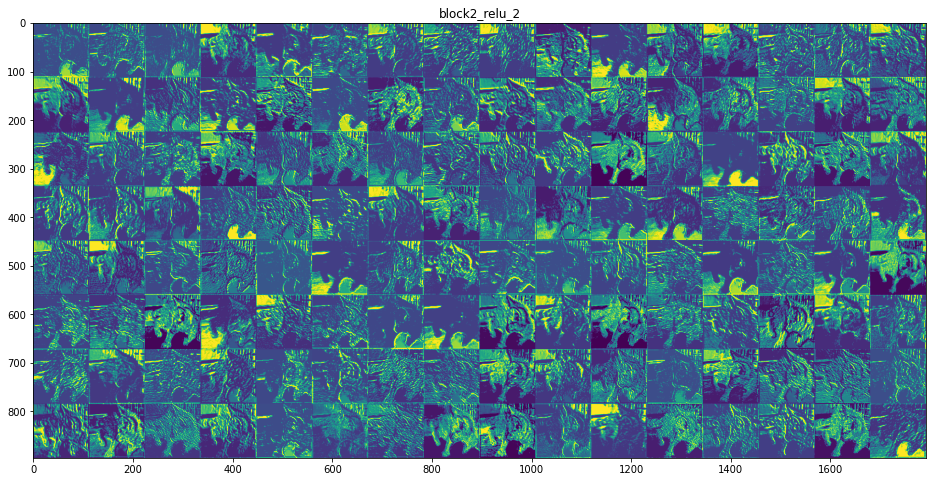

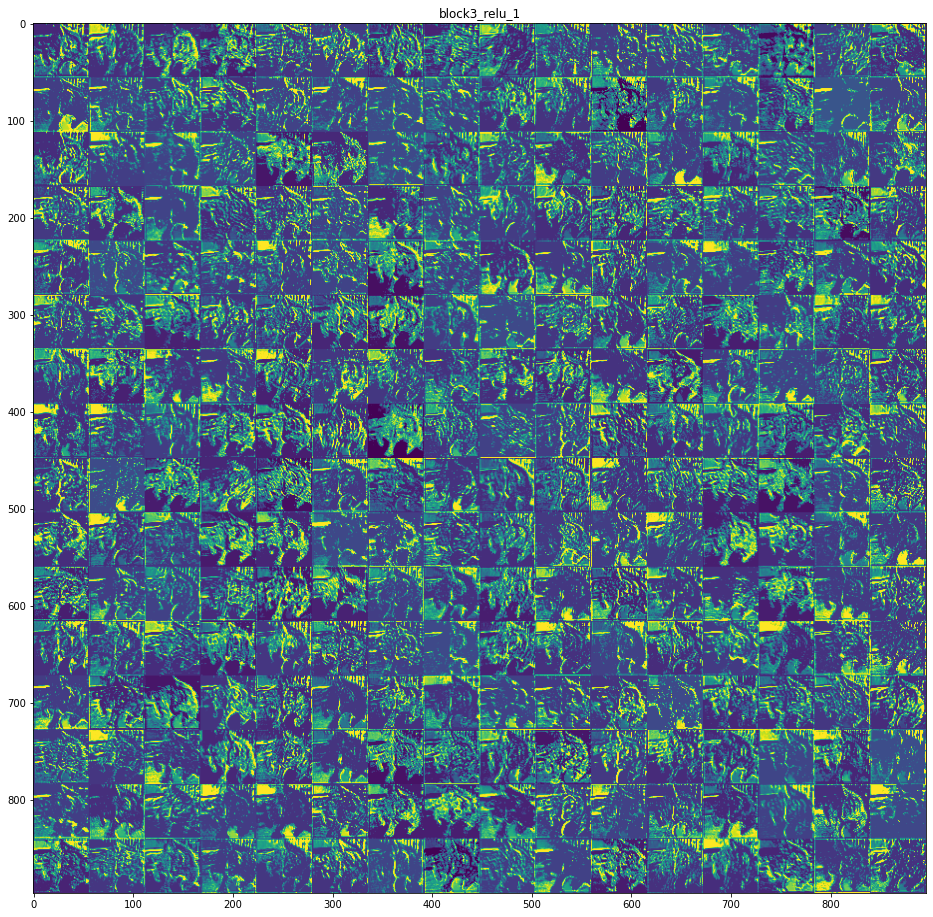

...

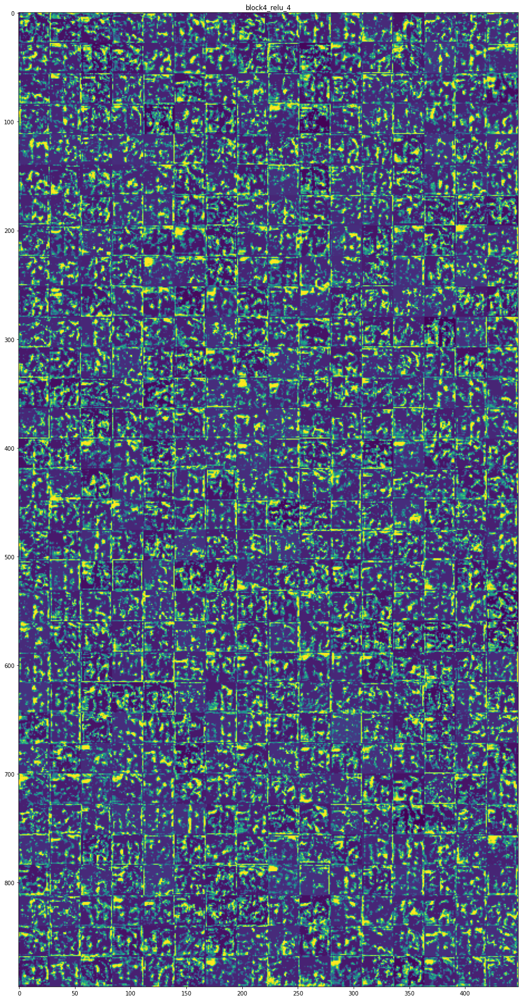

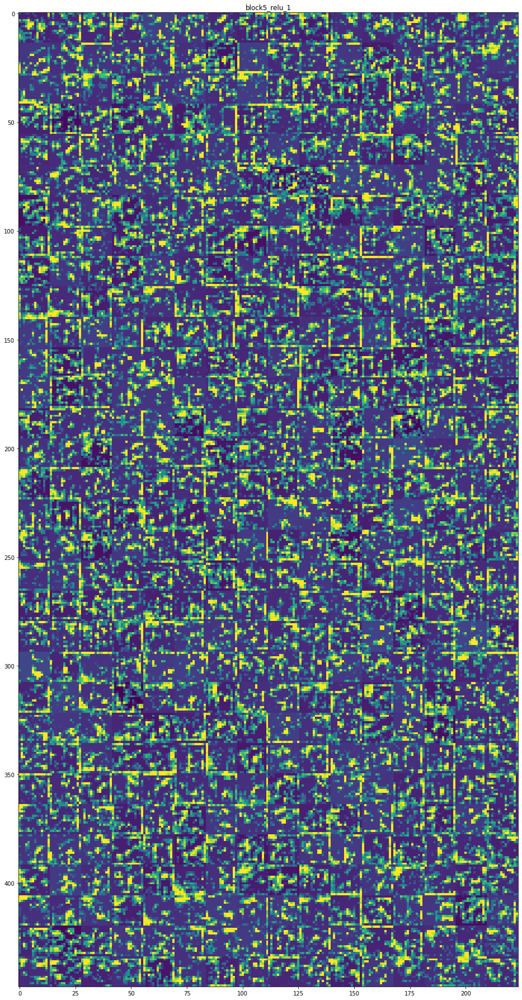

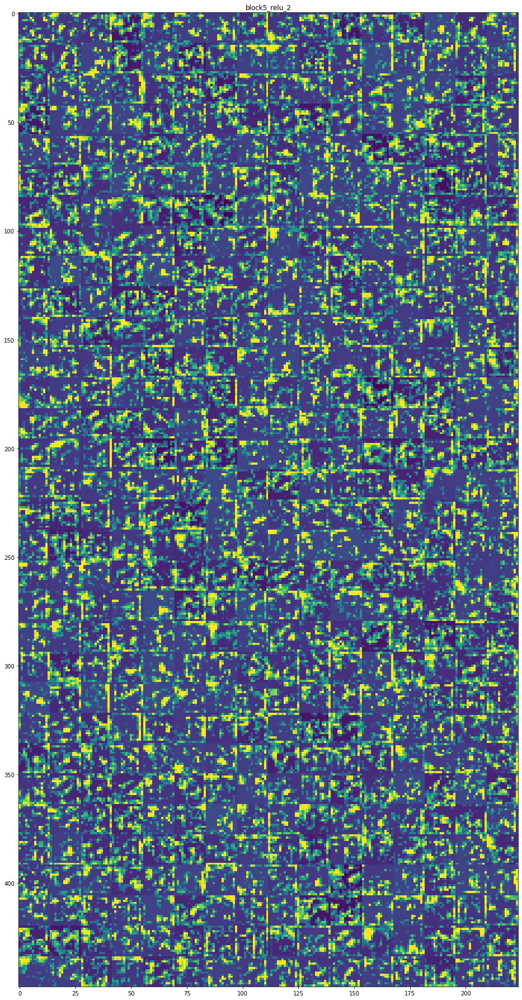

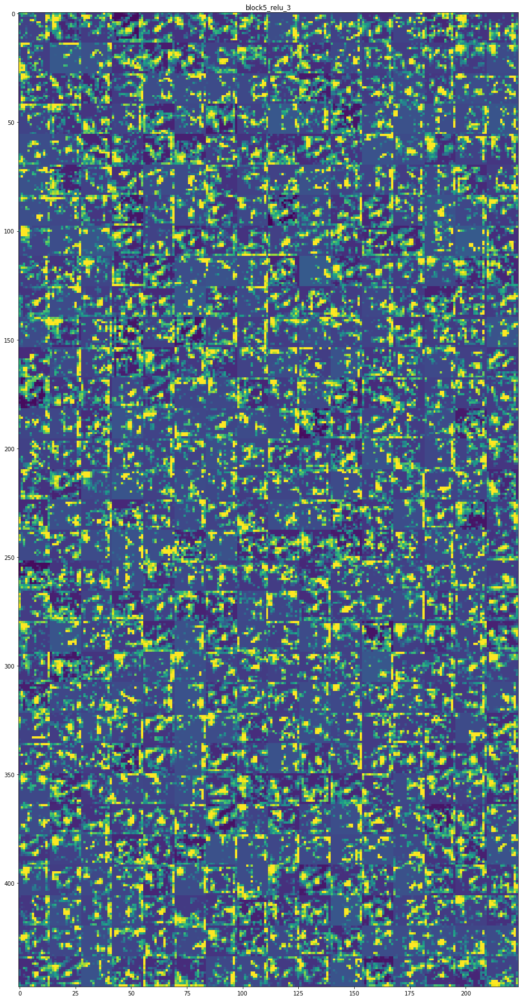

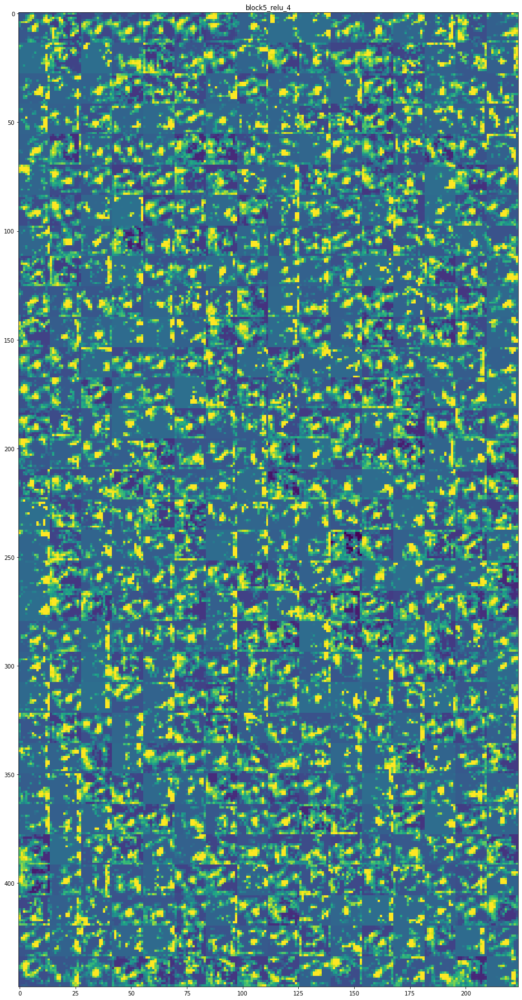

In [16]:
image_per_row = 16

show_activations(image_per_row=image_per_row)